In [1]:
import json
from ranker import *
from relevance import *
from indexing import *
import importlib
import sys
importlib.reload(sys.modules['indexing'])
from document_preprocessor import RegexTokenizer
import csv

/Users/leilei/Desktop/courses/si650/MusemIn/EECS-549-Information-Retrieval-Project-Museumin/document_preprocessor.py:202: SyntaxWarning: invalid escape sequence '\w'
  def __init__(self, token_regex: str = '\w+', lowercase: bool = True, multiword_expressions: list[str] = None) -> None:
/Users/leilei/Desktop/courses/si650/MusemIn/EECS-549-Information-Retrieval-Project-Museumin/document_preprocessor.py:203: SyntaxWarning: invalid escape sequence '\w'
  """
/opt/anaconda3/envs/py3.12.3/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [72]:
# set data path
metadata_path = 'data_1101/museum_wiki_metadata3.jsonl'
museumids_path = 'data_1101/museum_wiki_list.csv'
stopwords_path = 'data_1101/stopwords.txt'
relscore_path = 'data_1101/relevance_score.csv'

In [62]:
# read file
import csv

museum_metadata = []
with open(metadata_path,'rt') as f:
    for line in f :
        museum_metadata.append(json.loads(line))
        
stopwords = set()
with open(stopwords_path,'rt') as f:
    for line in f:
        stopwords.add(line.strip())

museumids={}
with open(museumids_path,'rt') as f:
    reader = csv.reader(f)
    for idx,row in enumerate(reader):
        if idx ==0:
            pass
        else:
            museumids[int(row[0])] = row[1]

In [6]:
len(museum_metadata)
museum_metadata[0].keys()

dict_keys(['museum_id', 'museum_name', 'museum_url', 'wiki_article', 'location', 'coordinates', 'other', 'museum_state', 'museum_wiki_decription', 'img_urls', 'wm_description'])

In [26]:
# index wiki article
index = BasicInvertedIndex()
preprocessor = RegexTokenizer('\w+')
wkindex = Indexer.create_index(index,metadata_path,preprocessor,stopwords,minimum_word_frequency=50,text_key='wiki_article')
wkindex.save('./wikiindex_1108')

100%|██████████| 5716/5716 [00:01<00:00, 3601.11it/s]


{'vocab': Counter({'s': 37336, 'museum': 34456, 'house': 19979, 'historic': 14129, 'national': 13108, 'building': 11977, 'history': 11144, 'state': 10586, 'park': 9484, 'art': 9311, 'center': 9227, 'collection': 8115, 'built': 8098, 'county': 8078, 'site': 7659, 'located': 7471, 'university': 7245, '000': 6572, '1': 6244, 'fort': 6233, 'states': 6222, 'home': 6188, 'p': 6054, 'historical': 5902, 'school': 5701, 'links': 5347, 'public': 5339, 'war': 5337, 'hall': 5330, 'external': 5327, 'city': 5289, 'north': 5220, 'including': 5097, 'years': 5055, 'society': 4950, 'area': 4878, 'year': 4657, 'places': 4570, '2': 4534, 'college': 4483, 'li': 4462, 'library': 4379, 'family': 4334, 'original': 4296, 'time': 4117, 'century': 4105, 'john': 4085, 'south': 3981, 'river': 3847, 'exhibits': 3767, 'opened': 3685, 'm': 3673, 'buildings': 3588, 'property': 3572, 'world': 3570, 'room': 3556, 'early': 3553, 'include': 3507, 'arts': 3445, 'gallery': 3376, 'part': 3374, 'official': 3317, 'west': 3316,

In [68]:
# use BM25 based on wiki-article body index generate initial pairs to be manually scored

queries = [
            # general category
            'performing arts, such as music, theater, or dance',
            'technological or scientific innovations',
            'engineering museums',
            'unique or unusual topics like pop culture, toys, or oddities',
            'honorable person',
            # specific category
            'Impressionist art', 
            'instruments from all around the world',
            'pop culture',
            #general location
            'museums are located on the university campuses',
            'museums in the east coast',
            # specific location
            'in chicago', 'in Detroit',
            # activity
            'opened on Veterans Day, attended by top military officials', 
            'educational programs for all ages',
            # general activity + location 
            'museums in San Francisco that host art workshops or classes', 
            'child-friendly in California', 
            'family days in New York',
            # general topic + location 
            "all the different experiences in being 'American.' in New York", 
            'the Michigan museum of science and industry',
            'transportation museum in Georgia',
            'local history in Michigan',
            # specific museum
            'National Portrait Gallery', # in the dataset
            'Museum of Science, Boston' # not in the dataset
]
    
ranker = Ranker(wkindex,preprocessor,stopwords,BM25(wkindex))
list2label = []
for query in queries:
    sorted_score = ranker.query(query)[:200]
    for id,score in sorted_score:
        list2label.append({'query':query,'museum_id':id,'museum_name':museumids[id],'score':score})

In [69]:
# import pandas as pd
# pd.DataFrame.from_dict(list2label).to_csv('list2label2.csv')

In [73]:
from collections import defaultdict,Counter
import seaborn as sns
import matplotlib.pyplot as plt

In [89]:
reldict = defaultdict(list)

with open(relscore_path,'rt') as f:
    reader = csv.reader(f)
    for idx,row in enumerate(reader):
        if idx ==0:
            pass
        else:
            reldict[row[0]].append((int(row[1]),row[2],int(row[4])))

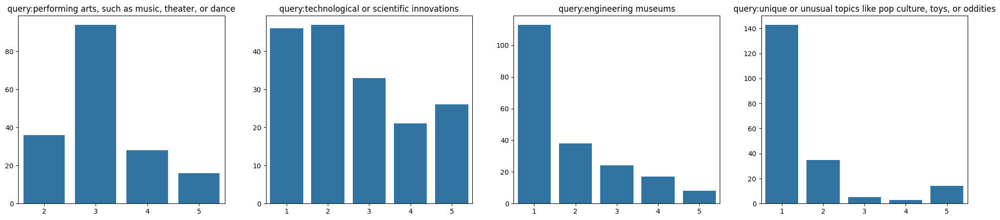

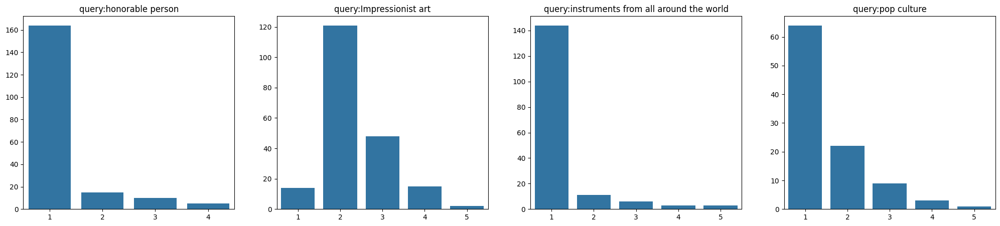

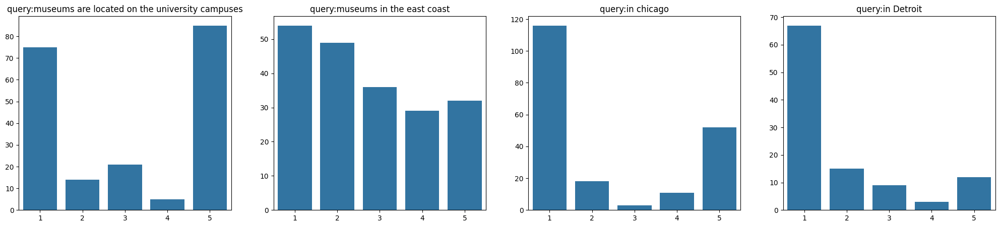

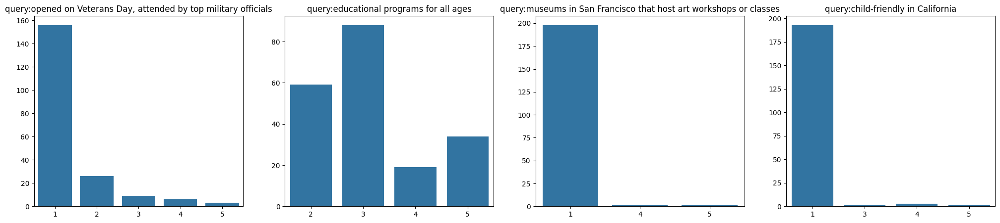

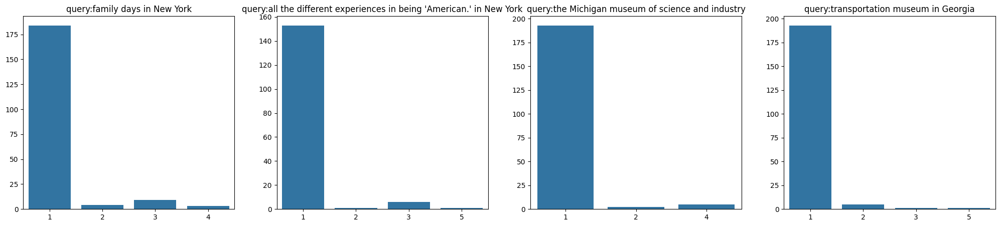

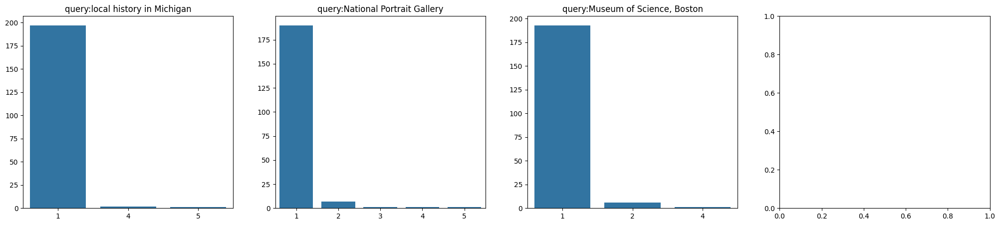

In [90]:
for idx,query in enumerate(queries):
    if (idx%4) ==0:
        fig,axes = plt.subplots(1,4,figsize = (25,5))
    
    value = reldict[query]
    relscore = [i[2] for i in value]
    counter =[(score,num) for score,num in Counter(relscore).items()]
    sortedcounter = sorted(counter,key = lambda x:x[0],reverse=False)
    
    sns.barplot(ax = axes[idx%4], x=[i[0] for i in sortedcounter], y =[i[1] for i in sortedcounter])
    axes[idx%4].set_title(f'query:{query}')


100%|██████████| 23/23 [00:03<00:00,  6.01it/s]


<Axes: xlabel='score_type', ylabel='score'>

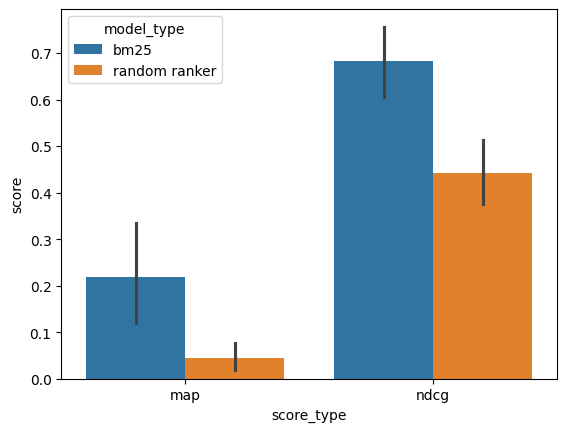

In [112]:
importlib.reload(sys.modules['relevance'])
importlib.reload(sys.modules['ranker'])
from relevance import run_relevance_tests
from ranker import *


def df2df(dt:dict,model_name:str):
    df = []
    for query,score in dt['map_list'].items():
        df.append({'score_type':'map','query':query,'score':score,'model_type':model_name})
    for query,score in dt['ndcg_list'].items():
        df.append({'score_type':'ndcg','query':query,'score':score,'model_type':model_name})
    
    return df
    
    
bm25dict = run_relevance_tests(relscore_path,ranker)
rdranker = Ranker(wkindex,preprocessor,stopwords,RandomRanker())
rddict = run_relevance_tests(relscore_path,rdranker)

df1 = df2df(bm25dict,'bm25')
df2 = df2df(rddict,'random ranker')
df1.extend(df2)

df2df = pd.DataFrame.from_dict(df1)
sns.barplot(df2df,x = 'score_type',y='score',hue = 'model_type')

## autocomplete & chunking

In [81]:
import importlib
import sys
from chunker import *
importlib.reload(sys.modules['chunker'])
from chunker import SemanticChunker
import json
import re 

filename = 'data_1101/museum_wiki_metadata3.jsonl'
with open(filename,'rt') as f:
    dataset = [json.loads(line) for line in f]

chunker = BySectionChunker(textkeys=['wiki_article','wm_decription'])
chunker.create_chunks(dataset)

chunks = chunker.chunks
pattern = re.compile('<.*?>')
for idx,chunk in enumerate(chunks):
    chunks[idx]['text'] = re.sub(pattern,'',chunk['text'])
    
chunker.chunks = chunks
chunker.save()

100%|██████████| 5716/5716 [00:00<00:00, 14959.36it/s]

successfully saved!


In [ ]:
import importlib
import sys
from autocomplete import Mautocomplete
importlib.reload(sys.modules['autocomplete'])
from autocomplete import Mautocomplete

autocomplete = Mautocomplete()
autocomplete.search('museu')

In [117]:
from transformers import T5Tokenizer, T5ForConditionalGeneration
from collections import defaultdict
import pandas as pd 
import pickle

model_name = 'doc2query/msmarco-t5-base-v1'
tokenizer = T5Tokenizer.from_pretrained(model_name)
model = T5ForConditionalGeneration.from_pretrained(model_name)

doc2query = []
for chunk in tqdm(chunks,total = len(chunks)):
    input_ids = tokenizer.encode(chunk['text'], max_length=320, truncation=True, return_tensors='pt')
    outputs = model.generate(
        input_ids=input_ids,
        max_length=64,
        do_sample=True,
        top_p=0.95,
       num_return_sequences=3)
    for output in outputs:
        doc2query.append({'museum_id':chunk['museum_id'],'genquery':tokenizer.decode(output, skip_special_tokens=True)})

# pd.DataFrame.from_dict(doc2query,'doc2query.csv')
    

100%|██████████| 32231/32231 [13:03:38<00:00,  1.46s/it]     


In [119]:
pickle.dump(doc2query,open('doc2query.pkl','wb'))

In [18]:
import pickle

doc2query = pickle.load(open('./data_1101/doc2query.pkl','rb'))
id2text = pickle.load(open('./__cache__/id2text.pkl','rb'))

In [ ]:
doc2query_gp = []
for idx,item in enumerate(doc2query):
    if idx%3 ==0:
        gp = [item['genquery']]
    elif idx%3 ==2:
        gp.append(item['genquery'])
        doc2query_gp.append(gp)
    else:
        gp.append(item['genquery'])
len(doc2query_gp)
doc2query_gp

In [42]:
import json

doc2query_gp2 = []
subtext2museum = []
idx = 0

for text,gp in zip(id2text,doc2query_gp):
    if len(text['text'])>200:
        for query in gp:
           doc2query_gp2.append({'id':idx,'museum_id':text['museum_id'],'query':query})
        idx +=1
        subtext2museum.append({'id':idx,'museum_id':text['museum_id'],'text':text['text']})

with open('./data_1101/subid_musuemid_query_200.jsonl','w') as f:
    for line in doc2query_gp2:
        f.write(json.dumps(line)+'\n')

with open('./data_1101/subid_museumid_text_200.jsonl','w') as f:
    for line in subtext2museum:
        f.write(json.dumps(line)+'\n')